# SISR Workshop

In [2]:
# Own imports
from Config.Config import Path
from Dataset.Dataset_UE import Dataset_UE, load_exr_file, save_exr
from Utils.Utils import save_model, load_model
from Training_Pipeline import training_pipeline

C:\Users\andry\Anaconda3\envs\pytorch_env\lib\site-packages\torchvision\io\image.py:13: UserWarning: Failed to load image Python extension: [WinError 127] The specified procedure could not be found
  warn(f"Failed to load image Python extension: {e}")
C:\Users\andry\Anaconda3\envs\pytorch_env\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
C:\Users\andry\Anaconda3\envs\pytorch_env\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [3]:
from Losses.Loss_Combined import Loss_Combined
from Losses.Loss_MAE import Loss_MAE
from Losses.Loss_MSE import Loss_MSE
from Losses.PerceptualLosses.PerceptualLoss_VGG import PerceptualLoss_VGG
from NeuralNetworks.NN_Base import Model_Base
from NeuralNetworks.UNet import Model_UNET
from NeuralNetworks.Model_Custom import Model_Custom
from NeuralNetworks.Model_NoCheckerboard import Model_NoCheckerboard
from Dataset.Dataset_Base import Dataset_Base
from Dataset.Dataset_UE import Dataset_UE, FullDataset_UE
from Config.Config import CurrentDevice, GetTrainingsPath, GetInferencePath

from torch.utils.data import DataLoader
from torch import optim
from typing import Any, Dict, Union, Optional
from pathlib import Path
from functools import partial
from dataclasses import dataclass

import torch
import torch.nn as nn
import inspect


@dataclass()
class ModelHyperparameters:
    in_channels: int = 3
    out_channels: int = 3
    learning_rate: float = 0.001
    batch_size: int = 32
    num_epochs: int = 15

    def __iter__(self):
        return iter(astuple(self))


# Default Configs Hyperparameters of model
HyperparametersDict = {
    "className": ModelHyperparameters,
    "args": {
        "in_channels": 3,
        "out_channels": 3,
        "learning_rate": 0.0001,
        "batch_size": 32,
        "num_epochs": 600,
    },
}

# Core dict contains paths to folders, dtype used in model, device etc.
model_stem = f"Model_NoCheckerboard/Epochs_{HyperparametersDict['args']['num_epochs']}_1_2_VGG600epochs_baseline_noBNL1VGG"
CoreDict = {
    "run_training": True,
    "load_model": False,
    "device": CurrentDevice,
    "dtype": torch.float32,
    "model_save_path": GetTrainingsPath(stem=model_stem),  # maybe use partial here
    "model_load_path": GetTrainingsPath(stem=model_stem),
    "model_inference_path": GetInferencePath(stem=model_stem),
    "cached_ds": False,
}

TrainDatasetDict = {
    "className": FullDataset_UE,
    "args": {
        "name": "FullDataset_UE",
        "ds_root_path": Path("F:/MASTERS/UE4/DATASET/"),
        "ue_projects_list": ["SubwaySequencer_4_26_2", "Rainforest_Scene_4_26_2"],
        "crop_coords": (900, 1028, 500, 628),
        # "crop_coords": (900, 964, 500, 564),
        "transforms": None,
        "cached": CoreDict["cached_ds"],
    },
}

ValidDatasetDict = {
    "className": Dataset_UE,
    "args": {
        "name": "Dataset_UE",
        "ds_root_path": Path(
            "F:/MASTERS/UE4/DATASET/InfiltratorDemo_4_26_2/DumpedBuffers"
        ),
        "csv_root_path": Path(
            "F:/MASTERS/UE4/DATASET/InfiltratorDemo_4_26_2/DumpedBuffers/info_Native.csv"
        ),
        "crop_coords": (900, 1028, 500, 628),
        # "crop_coords": (900, 964, 500, 564),
        "transforms": None,
        "cached": CoreDict["cached_ds"],
    },
}

TrainDataloaderDict = {
    "className": DataLoader,
    "args": {
        "dataset": None,
        "batch_size": HyperparametersDict["args"]["batch_size"],
        "shuffle": True,
        "drop_last": True,
        "pin_memory": True,
    },
}

ValidDataloaderDict = {
    "className": DataLoader,
    "args": {
        "dataset": None,
        "batch_size": HyperparametersDict["args"]["batch_size"],
        "shuffle": True,
        "drop_last": True,
        "pin_memory": True,
    },
}

ModelDict = {
    "className": Model_NoCheckerboard,
    "args": {
        "in_channels": HyperparametersDict["args"]["in_channels"],
        "out_channels": HyperparametersDict["args"]["out_channels"],
    },
}

CriterionDict = {
    "className": Loss_Combined,
    "args": {
        "criterions": [Loss_MAE(), PerceptualLoss_VGG()],
        "criterionContribution": [1.0, 1.0],
        "device": CurrentDevice,
    },
}

OptimizerDict = {
    "className": optim.AdamW,
    "args": {"params": None, "lr": HyperparametersDict["args"]["learning_rate"]},
}

""" 
    Training, Dataset, Model etc. config, device, dtype utility
"""


class ConfigMapping(dict):
    """
    Config Mapping for config utility, stores a pre-defined
    values for training, inference, loss, model etc.

    e.g.,
    config[HyperparametersDict]   = HyperparametersDict['args']
    config[TrainDatasetDict]      = TrainDatasetDict['args']
    config['device']              = torch.device("cpu")
    """

    def __init__(self, mapping=None, *args: dict):
        if mapping is None:
            mapping = {}
        if args:
            for arg in args:
                mapping[str(arg["className"].__name__)] = arg["args"]

        super().__init__(mapping)

    def __getitem__(self, key: str = None) -> Any:
        assert key is not None
        return super().__getitem__(key)

    def __setitem__(self, key: [dict, str] = None, value: Union[dict, str, Any] = None):
        assert key is not None and value is not None, "key and value must be specified"
        # TODO Check if every argument is specified in value, otherwise set to None or raise error
        super().__setitem__(key, value)

    def __repr__(self) -> str:
        output_str = str()

        num_spaces = lambda len_str: 25 - len_str
        tabulation = "  "  # len == 2 -> is a amount of spaces, if value is dict, for better formatting e.g., tabulation (TAB, tabulation is usually a 4 spaces)
        for key, value in self.items():
            if type(value) is dict:
                output_str = output_str + f"{key} \n"
                spaces = " " * num_spaces(len("ClassName"))
                output_str = (
                    output_str
                    + f"{tabulation}ClassName: {spaces} {self[key]['className'].__name__} \n"
                )
                for subKey, subValue in self[key]["args"].items():
                    spaces = " " * num_spaces(len(subKey))
                    output_str = (
                        output_str + f"{tabulation}{subKey}: {spaces} {subValue} \n"
                    )
            else:
                spaces = " " * num_spaces(len(key) - len(tabulation))
                output_str = output_str + f"{key}: {spaces} {value} \n"

        return output_str

def initObjectFromConfig(className: type, *args, **kwargs):
    """
    Initializes object from given config,

    e.g.,
    className == DataLoader
    kwargs ==
        'dataset':              None,
        'batch_size':           32,
        'shuffle':              True,
        'drop_last':            True,
        'pin_memory':           True

    Arg is optional, if args are specified, then function overwrites
    kwargs from beginning to len(args) - 1
    """

    if len(args) != 0:
        for idx, (kwargKey, kwargValue) in enumerate(kwargs.items()):
            if idx == len(args):
                break
            kwargs[kwargKey] = args[idx]

    return className(**kwargs)


def configJSONSerializer(config: ConfigMapping = None):
    assert config is not None, "config must be specified"
    import json

    with open(config["model_save_path"] / "training_config.json", "w") as convertFile:
        convertFile.write(str(config))


C:\Users\andry\Anaconda3\envs\pytorch_env\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
C:\Users\andry\Anaconda3\envs\pytorch_env\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [4]:
# Initialize config
config = ConfigMapping(CoreDict)
config["hyperparameters"] = HyperparametersDict
config["trainDS"] = TrainDatasetDict
config["validDS"] = ValidDatasetDict
config["trainDL"] = TrainDataloaderDict
config["validDL"] = ValidDataloaderDict
config["model"] = ModelDict
config["criterion"] = CriterionDict
config["optimizer"] = OptimizerDict
print(config)

run_training:                 True 
load_model:                   False 
device:                       cuda:0 
dtype:                        torch.float32 
model_save_path:              F:\MASTERS\Upscaler\Results\2023-04-17\Trainings\Model_NoCheckerboard\Epochs_600_1_2_VGG600epochs_baseline_noBNL1VGG 
model_load_path:              F:\MASTERS\Upscaler\Results\2023-04-17\Trainings\Model_NoCheckerboard\Epochs_600_1_2_VGG600epochs_baseline_noBNL1VGG 
model_inference_path:         F:\MASTERS\Upscaler\Results\2023-04-17\Inference\Model_NoCheckerboard\Epochs_600_1_2_VGG600epochs_baseline_noBNL1VGG 
cached_ds:                    False 
hyperparameters 
  ClassName:                  ModelHyperparameters 
  in_channels:                3 
  out_channels:               3 
  learning_rate:              0.0001 
  batch_size:                 32 
  num_epochs:                 600 
trainDS 
  ClassName:                  FullDataset_UE 
  name:                       FullDataset_UE 
  ds_root_path:     

In [6]:
from Upscaler.Colorspace.PreProcessing import tonemap_reinhard
def show_tensor(tens:torch.tensor=None, exposure:float=1.0, figsize:Tuple[int, int]=(20,20)):
    assert tens is not None, "show_tensor function requires tensor != None"
    
    tens = tens.float() * exposure
    tens = tonemap_reinhard(tens)
    npimg = tens.detach().numpy()
    
    plt.figure(figsize=figsize)    
    plt.imshow(np.transpose(npimg, (1,2,0)))

In [7]:
#CHW Format
tens = load_exr_file("F:/MASTERS/UE4/DATASET/InfiltratorDemo_4_26_2/DumpedBuffers/1920x1080-native/SceneColor/88.exr").float()
#NCHW Format
b_tens = tens.unsqueeze(0) 

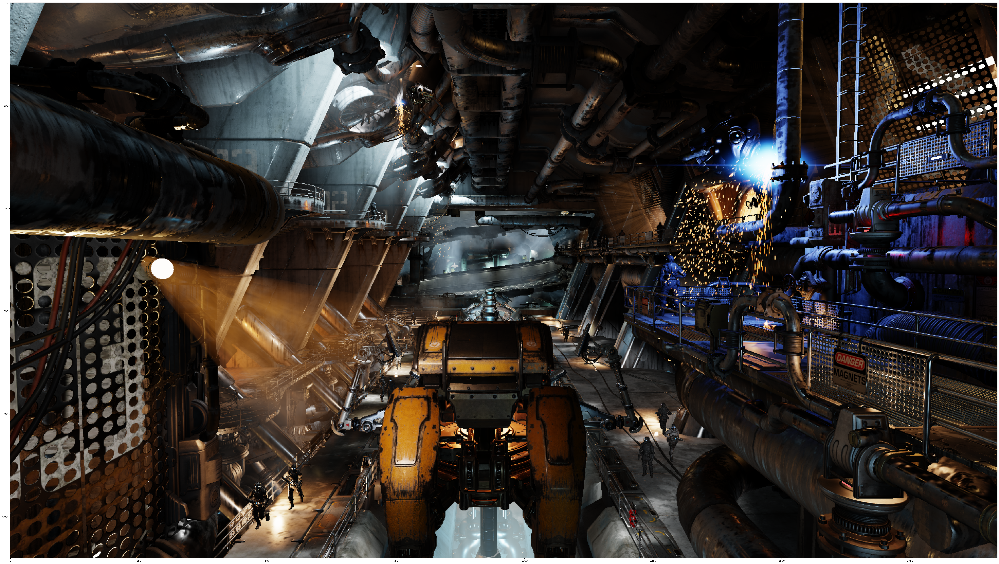

In [8]:
show_tensor(tens, exposure=10.0, figsize=(70,70))

# What is a UNET?


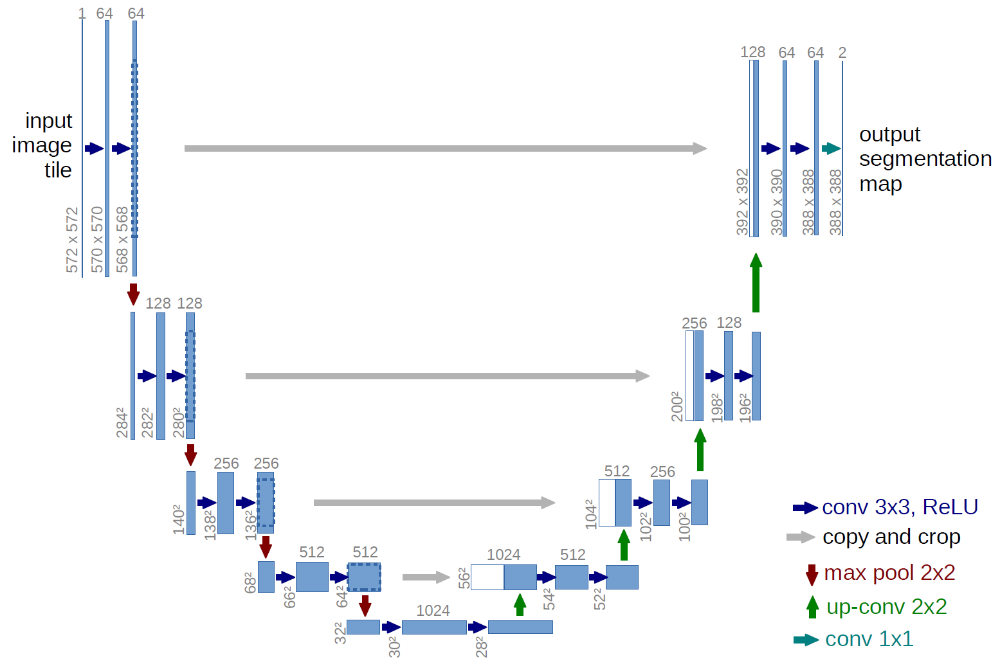

In [9]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms.functional as tvf
import numpy as np

from NeuralNetworks.NN_Base import Model_Base
from Config.Config import TensorType, ShapeType
from typing import Optional, Tuple


class DoubleConv(nn.Module):
    """
    Double Conv Block of UNET

    Attributes
    ----------
    in_channels : int
        Amount of input channels to downsample block
    out_channels : int
        Amount of output channels to downsample block
    ----------
    """

    def __init__(self, in_channels: int, out_channels: int):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
        )

    def forward(self, x: TensorType = None) -> TensorType:
        assert x is not None, "Input tensor X can't be None!"
        return self.conv(x)


class DownsampleBlock(nn.Module):
    """
    Downsample Block of UNET

    Attributes
    ----------
    in_channels : int
        Amount of input channels to downsample block
    out_channels : int
        Amount of output channels to downsample block
    pool_layer: Optional[nn.Module]
        Optional pooling layer for block, if not specified == nn.MaxPool2d(kernel_size=(2, 2), stride=2)
    ----------
    """

    def __init__(
        self,
        in_channels: int,
        out_channels: int,
        pool_layer: Optional[nn.Module] = None,
    ):
        super().__init__()
        self.conv = DoubleConv(in_channels, out_channels)
        self.pool = pool_layer
        if pool_layer is None:
            self.pool = nn.MaxPool2d(kernel_size=(2, 2), stride=2)

    def forward(self, x: TensorType = None) -> Tuple[TensorType, TensorType]:
        assert x is not None, "Input tensor X can't be None!"

        conv_out = self.conv(x).clone()
        return self.pool(conv_out), conv_out


class UpsampleBlock(nn.Module):
    """
    Upsample Block of UNET

    Attributes
    ----------
    in_channels : int
        Amount of input channels to upsample block
    out_channels : int
        Amount of output channels to upsample block
    ----------
    """

    def __init__(self, in_channels: int, out_channels: int):
        super().__init__()
        self.conv_transpose2d = nn.ConvTranspose2d(
            in_channels, out_channels, kernel_size=2, stride=2
        )
        self.conv = DoubleConv(in_channels, out_channels)

    def forward(
        self, x: TensorType = None, skip_connection: TensorType = None
    ) -> TensorType:
        assert (
            x is not None and skip_connection is not None
        ), "Input tensor X and skip_connection can't be None!"

        x = self.conv_transpose2d(x)
        # if shape of skip connection is not equal to input tensor, then just resize it
        # It may differ with 2,1 pixels in dim, due to pooling (max pool)
        if skip_connection.shape != x.shape:
            x = tvf.resize(x, size=(skip_connection.size(-2), skip_connection.size(-1)))

        x = torch.cat([skip_connection, x], dim=1)
        return self.conv(x)


class Model_UNET(Model_Base):
    """
    UNET architecture based model

    Attributes
    ----------
    name : str
        Name of Model
    input_shape : ShapeType (look at Config.py)
        Input shape to the network
    in_channels : int
        Number of input channels to the network
    out_channels : int
        Number of output channels to the network
    ----------
    """

    def __init__(
        self,
        name: str = "Model_UNET",
        input_shape: ShapeType = (1, 3, 1920, 1080),
        in_channels: int = 3,
        out_channels: int = 3,
    ):
        super().__init__(name, input_shape)

        # Uniforms
        self.in_channels = in_channels
        self.out_channels = out_channels

        # Amout of conv features per layer
        conv_features = np.array([64, 128, 256, 512], dtype=np.int32)

        # Skip connections
        self.skip_connections = [
            torch.empty((1, 1, 1, 1)),
            torch.empty((1, 1, 1, 1)),
            torch.empty((1, 1, 1, 1)),
            torch.empty((1, 1, 1, 1)),
        ]

        # Downsample layers
        self.downsample_block1 = DownsampleBlock(in_channels, conv_features[0])
        self.downsample_block2 = DownsampleBlock(conv_features[0], conv_features[1])
        self.downsample_block3 = DownsampleBlock(conv_features[1], conv_features[2])
        self.downsample_block4 = DownsampleBlock(conv_features[2], conv_features[3])

        # Bottleneck layer
        self.bottleneck = DoubleConv(conv_features[3], conv_features[3] * 2)

        # Upsample layers
        self.upsample_block1 = UpsampleBlock(conv_features[3] * 2, conv_features[3])
        self.upsample_block2 = UpsampleBlock(conv_features[2] * 2, conv_features[2])
        self.upsample_block3 = UpsampleBlock(conv_features[1] * 2, conv_features[1])
        self.upsample_block4 = UpsampleBlock(conv_features[0] * 2, conv_features[0])

        # Last upsample conv
        # self.upsample_block5 = UpsampleBlock(conv_features[0], conv_features[0] // 2)
        self.upsample_block5 = nn.ConvTranspose2d(
            conv_features[0], conv_features[0] // 2, kernel_size=2, stride=2
        )

        # Final convolution
        self.final_conv = nn.Conv2d(
            conv_features[0] // 2, self.out_channels, kernel_size=1
        )  # 1x1 convolution at the end

    def forward(self, x: TensorType = None) -> TensorType:
        assert x is not None, "Input tensor X can't be None!"

        # Downsample
        for idx in [1, 2, 3, 4]:
            downsample_block = getattr(self, "downsample_block{}".format(idx))
            x, x1 = downsample_block(x)
            self.skip_connections[idx - 1] = x1

        # Bottleneck
        x = self.bottleneck(x).clone()

        # Upsample
        for idx in [1, 2, 3, 4]:
            upsample_block = getattr(self, "upsample_block{}".format(idx))
            x = upsample_block(
                x, self.skip_connections[len(self.skip_connections) - idx]
            )

        x = self.upsample_block5(x)
        # Final, last conv
        # TODO Add next conv, to reach upsampling. Right now: out shape == in shape. Should be -> 2x upsaling
        return self.final_conv(x)

In [10]:
model = Model_UNET(in_channels=3, out_channels=3).to(device=CurrentDevice)
preds = model(b_tens.to(device=CurrentDevice))

OutOfMemoryError: CUDA out of memory. Tried to allocate 508.00 MiB (GPU 0; 8.00 GiB total capacity; 6.99 GiB already allocated; 0 bytes free; 7.05 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

In [ ]:
show_tensor(preds, exposure=10.0, figsize=(70,70))

# Transposed convolution and their checkerboard artifact

In [ ]:
# Show training results with and without deconvolutions

In [ ]:
from Upscaler.NeuralNetworks.PreDefined_Blocks import *

## Upscaling with Transposed Conv and Analitical Upscale + Conv

In [ ]:
# conv_transpose2d_conv = nn.Sequential(
#     nn.ConvTranspose2d(
#     3, 3, kernel_size=2, stride=2)
# )

# upscale_conv = nn.Sequential(
#     nn.Upsample(scale_factor=(2,2)),
#     nn.Conv2d(3, 3, kernel_size=1), #1x1 conv
# )
# conv_transpose2d_conv[0].weight.data.fill_(1.)
# upscale_conv[1].weight.data.fill_(1.)
# torch.nn.init.xavier_uniform_(conv_transpose2d_conv[0].weight)   
# torch.nn.init.xavier_uniform_(upscale_conv[1].weight)                       

In [ ]:
conv_transpose2d_conv = nn.Sequential(
    nn.ConvTranspose2d(
    3, 3, kernel_size=2, stride=2)
)

upscale_conv = nn.Sequential(
    nn.Upsample(scale_factor=(2,2)),
    nn.Conv2d(3, 3, kernel_size=1), #1x1 conv
)

if False:
    torch.nn.init.xavier_uniform_(conv_transpose2d_conv[0].weight)   
    torch.nn.init.xavier_uniform_(upscale_conv[1].weight)     

# out = conv_transpose2d_conv(tens)
# out1 = upscale_conv(tens.unsqueeze(0)).squeeze(0)

# show_tensor(out[..., :200, :300], exposure=10.0, figsize=(70,70))
# show_tensor(out1[..., :200, :300], exposure=3.0, figsize=(70,70))

## Example outputs of Transposed Conv
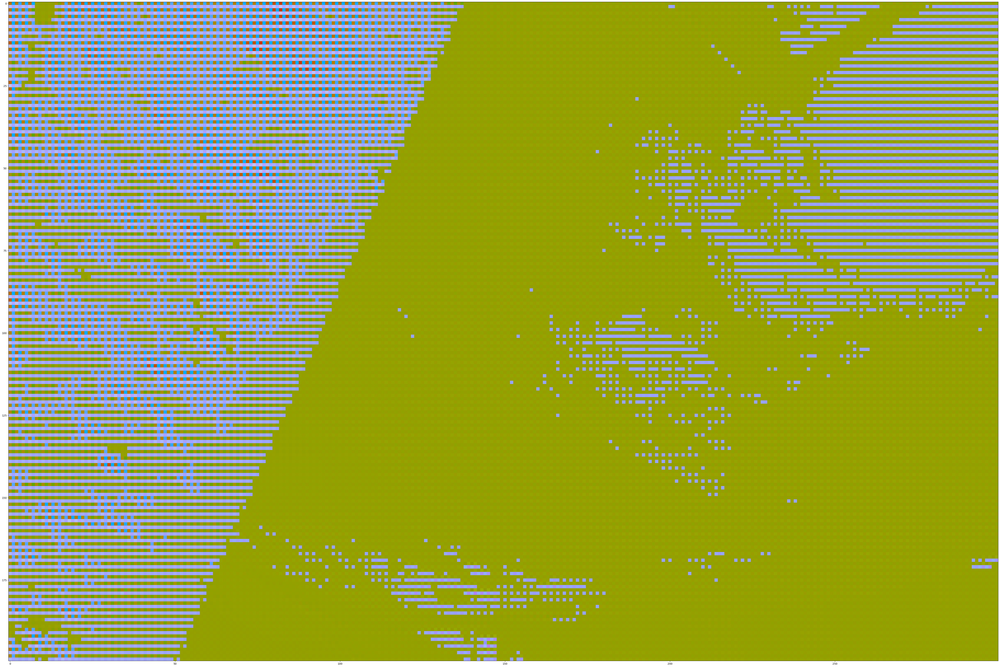
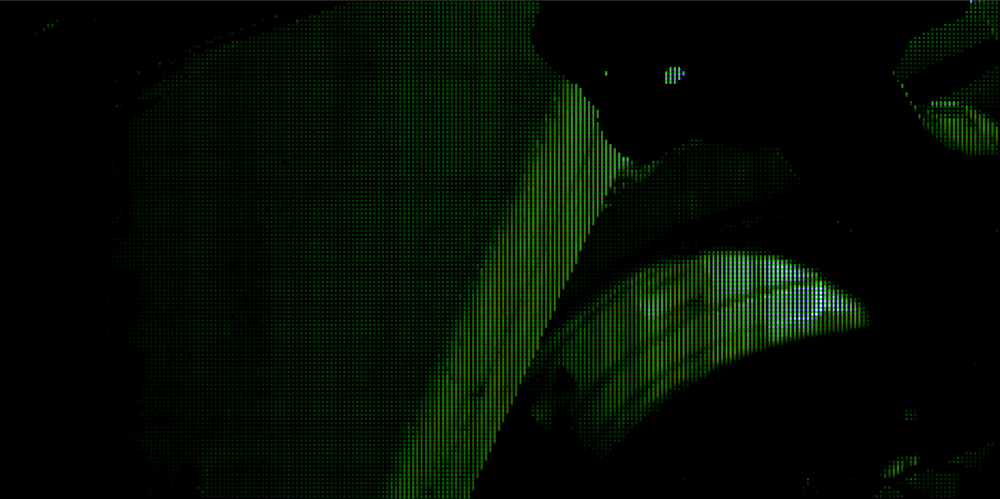

## Example outputs of Upscale NN + Conv
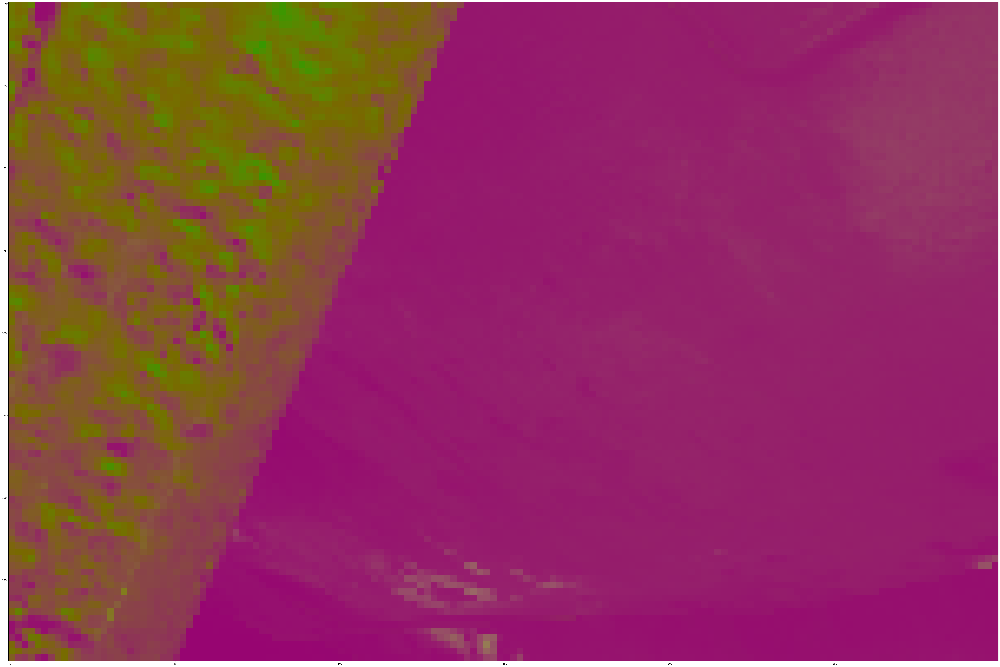
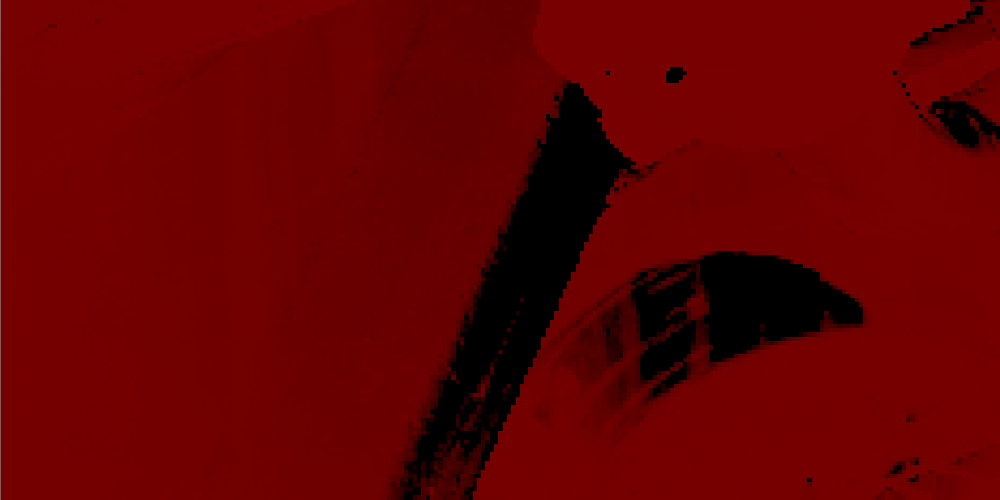

In [ ]:
# save_exr("F:/MASTERS/out.exr", out)
# save_exr("F:/MASTERS/out1.exr", out1)

# Why L1 norm is better than L2 norm for Super Resolution tasks?

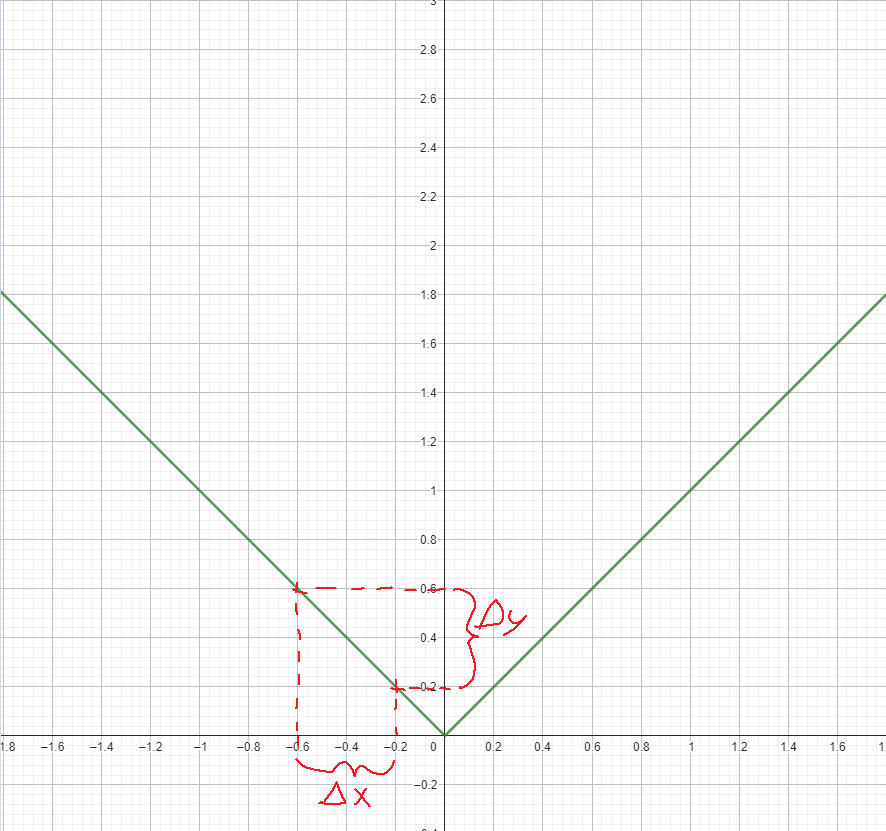

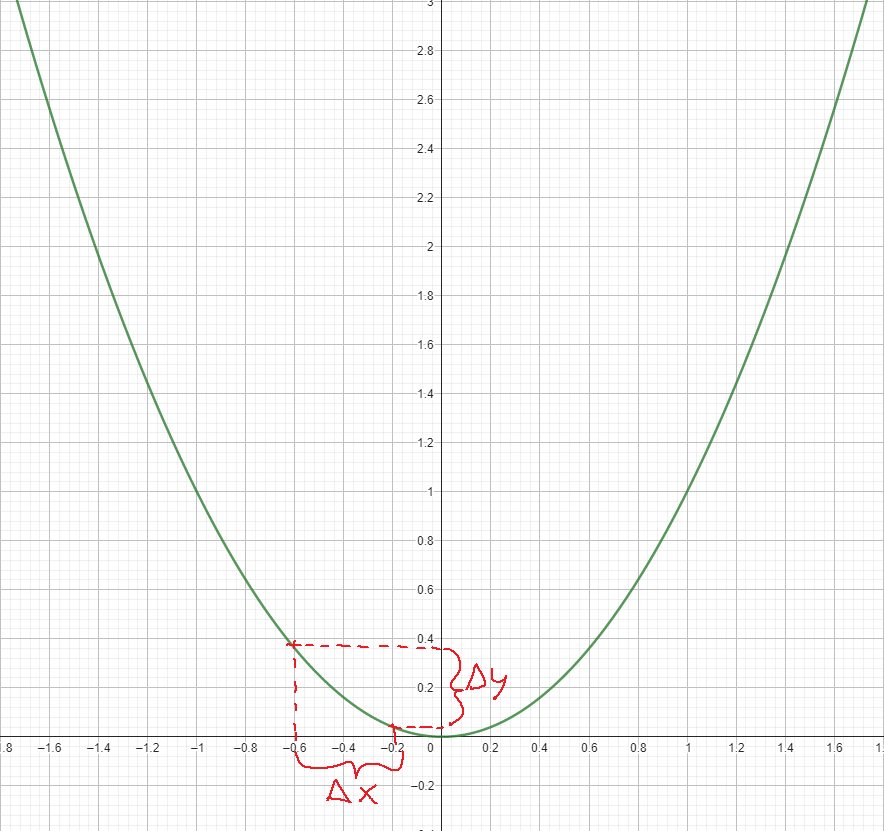

# Comparison

### Target (Ground-Truth)
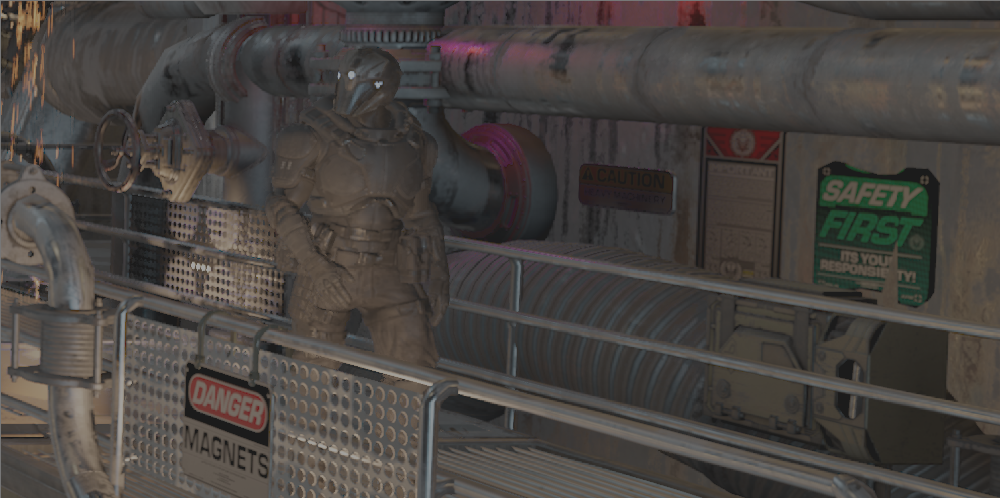

### MAE (L1) Prediction 
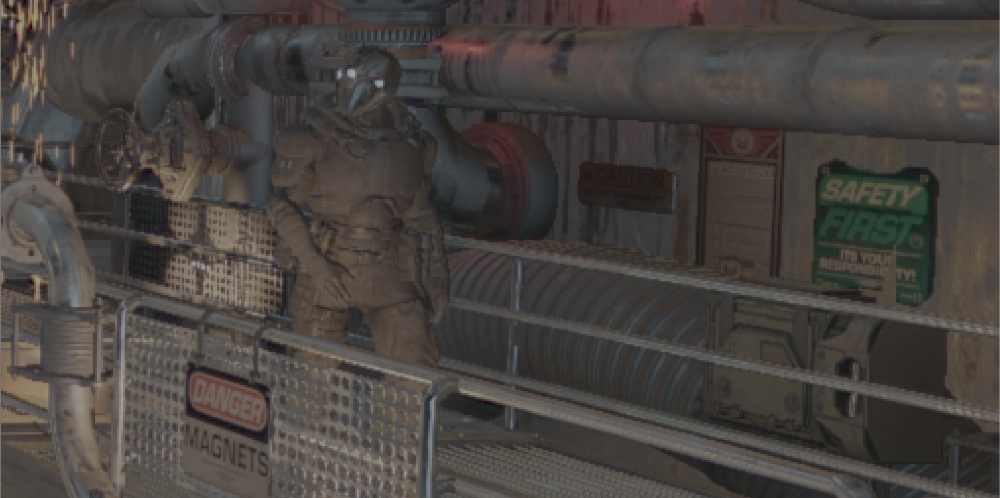

### MSE (L2) Prediction
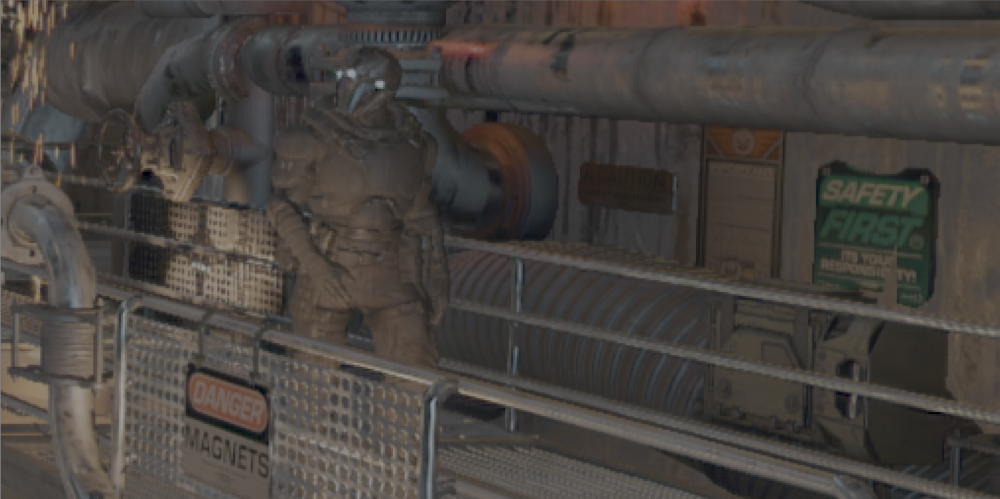